# Машинное обучение


## Одно из [определений МО](https://habr.com/ru/companies/ods/articles/322534/)

Классическое, общее [определение машинного обучения (МО)](https://www.deeplearningbook.org/contents/ml.html) звучит так ([T. Mitchell "Machine learning", 1997](https://www.cs.cmu.edu/~tom/files/MachineLearningTomMitchell.pdf)):

<blockquote>
Definition: A computer program is said to learn from experience E with respectto some class of tasks T and performance measure P, if its performance at tasks inT, as measured by P, improves with experience E.
</blockquote> 

__или другими словами__:
<blockquote>
Компьютерная программа обучается при решении какой-то задачи из класса $T$, если ее производительность, согласно метрике $P$, улучшается при накоплении опыта $E$.
</blockquote>

Далее в разных сценариях под $T$, $P$, и $E$ подразумеваются совершенно разные вещи. 

Среди самых популярных __задач $T$__ в машинном обучении:
* классификация – отнесение объекта к одной из категорий на основании его признаков
* регрессия – прогнозирование количественного признака объекта на основании прочих его признаков
* кластеризация – разбиение множества объектов на группы на основании признаков этих объектов так, чтобы внутри групп объекты были похожи между собой, а вне одной группы – менее похожи
* детекция аномалий – поиск объектов, "сильно непохожих" на все остальные в выборке либо на какую-то группу объектов
* и много других, более специфичных. 

Под __опытом $E$__ понимаются __данные__. Данные и в зависимости от этого алгоритмы машинного обучения могут быть поделены на те, что обучаются с учителем и без учителя (__supervised & unsupervised learning__). В задачах обучения без учителя имеется выборка, состоящая из объектов, описываемых набором признаков. В задачах обучения с учителем вдобавок к этому для каждого объекта некоторой выборки, называемой обучающей, известен целевой признак – по сути это то, что хотелось бы прогнозировать для прочих объектов, не из обучающей выборки.


_Пример_

Задачи классификации и регрессии – это задачи обучения с учителем. В качестве примера будем представлять задачу кредитного скоринга: на основе накопленных кредитной организацией данных о своих клиентах хочется прогнозировать невозврат кредита. Здесь для алгоритма опыт $E$ – это имеющаяся обучающая выборка: набор объектов (людей), каждый из которых характеризуется набором признаков (таких как возраст, зарплата, тип кредита, невозвраты в прошлом и т.д.), а также целевым признаком. Если этот целевой признак – просто факт невозврата кредита ($1$ или $0$, т.е. банк знает о своих клиентах, кто вернул кредит, а кто – нет), то это задача (бинарной) классификации. Если известно, на сколько по времени клиент затянул с возвратом кредита и хочется то же самое прогнозировать для новых клиентов, то это будет задачей регрессии.


Наконец, третья абстракция в определении машинного обучения – это __метрика оценки производительности алгоритма P__. Такие метрики различаются для разных задач и алгоритмов. Cамая простая метрика качества алгоритма, решающего задачу классификации – это доля правильных ответов (_accuracy_, не называйте ее точностью, этот перевод зарезервирован под другую метрику, _precision_) – то есть попросту доля верных прогнозов алгоритма на тестовой выборке.



## Фреймворк Scikit-learn

[__Scikit-learn (sklearn)__](https://scikit-learn.org/stable/) — [это](https://blog.skillfactory.ru/glossary/scikit-learn/) один из наиболее широко используемых пакетов Python для Data Science и Machine Learning. Он содержит функции и алгоритмы для машинного обучения: классификации, прогнозирования или разбивки данных на группы.

[Sklearn долгое время (с 2007) остаётся](https://habr.com/ru/companies/netologyru/articles/911216/) в стеке любого специалиста по анализу данных и ИИ, потому что хорошо закрывает типовые задачи ML: классификацию, регрессию, отбор признаков, масштабирование, кросс-валидацию. Когда данные уже лежат в таблице, а нужно быстро запустить задачу, с ней проще всего собрать работающий прототип. 

Все методы обработки данных, реализованные __scikit-learn__ реализуют единый и предсказуемый интерфейс, основанный на методах `.fit()`, `.predict()` и `.transform()`. Этот подход стал де-факто стандартом и был подхвачен другими библиотеками, такими как `LightGBM` и `XGBoost`/`CatBoost`, а также совеместим со многими библиотеками анализа данных, например `Optuna`. Благодаря этому инструменты анализа данных хорошо сочетаются друг с другом, а модели можно заменять без необходимости переписывать весь код.

Библиотека `sklearn` хорошо [сочетается ](https://habr.com/ru/companies/netologyru/articles/911216/) с остальными инструментами `Python`. Она работает с массивами `numpy` и датафреймами `pandas`, строит графики через `matplotlib`, сохраняет модели с помощью `joblib`.

Вводный гайд по основным функциям библиотеки может быть найден в [официальной документации](https://scikit-learn.org/stable/user_guide.html).

Также __полезно будет отметить__, что документация переводится на русский язык [scikit-learn.ru](https://scikit-learn.ru/stable/)

## Запуск библиотеки

In [173]:
try:
    import sklearn
except:
    %pip install scikit-learn

In [174]:
import sklearn

Дальше можно убедиться, что всё работает корректно: библиотека загружается, данные читаются, модель обучается. Для этого запустите простой пример на встроенном датасете `iris`.

Подключим четыре модуля:

* `datasets` — встроенные датасеты для тестов;
* `linear_model` — простые модели вроде логистической регрессии;
* `model_selection` — разбиение данных и кросс-валидация;
* `metrics` — функции для оценки качества.

In [175]:
from sklearn import datasets, linear_model, metrics, model_selection

# Загружаем данные
X, y = datasets.load_iris(return_X_y=True)

Функция `train_test_split` просто случайно выбирает, какие объекты пойдут в обучение, а какие — в тест. Но поведение этой функции можно настраивать.

In [176]:

# Разбиваем на обучение и тест
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.3, random_state=42)


У `sklearn` единый подход ко всем моделям: сначала данные передают в `fit`, потом получают предсказания через `predict`, а дальше оценивают результат — с помощью `score` или функций из `metrics`. Эта схема работает одинаково для разных алгоритмов, поэтому после первого примера становится понятно, как работает вся библиотека.



In [177]:
# Обучаем модель
model = linear_model.LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

# Получаем предсказания
y_pred = model.predict(X_test)

# Считаем метрику
accuracy = metrics.accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 1.00


И так, в примере загружается встроенный набор данных `iris`, где каждый объект — это параметры цветка, а цель — определить его класс. Данные делятся на обучающую и тестовую выборки: модель учится на одной части (`fit`) и проверяется на другой (`predict`). После этого считается метрика качества — точность (`accuracy`), то есть доля правильных ответов.



# Обработка набора данных

## Импорт

Напомним, что мы анализируем набор данных cars, содержащий записи о продажах автомобилей на вторичном рынке. Основная задача в данном датасете - это предсказание цены на автомобиль. С точки зрения `DataScience` мы будем решать задачу регрессии.

In [178]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import random


In [179]:
from sklearn.model_selection import train_test_split

Пока загрузим только численные колонки наших данных. Дело в том, что с категориальными колонками нужны особые механизмы работы - их пока трогать не будем.

In [180]:
df = pd.read_csv('https://raw.githubusercontent.com/MVRonkin/BasicDataAnalysisCourse/refs/heads/main/Workshops/cars_cleaned_num.csv', index_col=0)
# df = pd.read_csv('cars_cleaned_num.csv', index_col=0)

In [181]:
df.head(2)

,Year,Distance,Engine,Price,km_year
0,2011,195000.0,1800.0,7750.0,17727.272727
1,2014,135000.0,1500.0,8550.0,16875.000000


## Разделение данных на тренировочные и тестовые

Выбераем целевую колонку (`y`) и колонки входных данных (`X`)

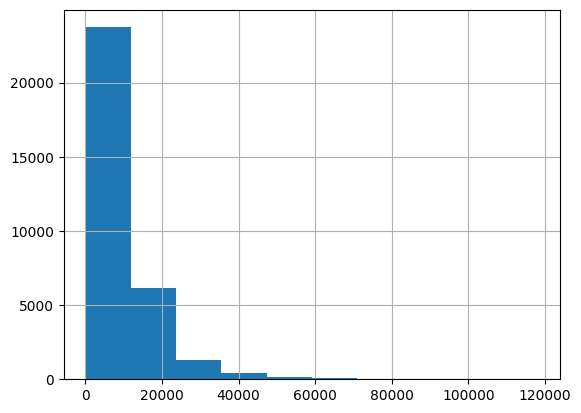

In [182]:
y = df["Price"]
X = df.drop(["Price"], axis = 1)
y.hist();

_Важно_ отметить, что особенностью методов обучения на больших данных является потенциальная ситуация переобучения/недообучения в ходе оптимизации. Проще всего это представить как ситуацию, в которой мы ошибемся в выбранных значениях коэффициентов. Такое явление может происходить если, например, модель будет воспринимать все ошибки, случайности и сознательные искажения входных данных как важные признаки для точного
ответа. 

_Другими словами_, для данных, участвующих в обучении (обучающая выборка), наша ошибка может стремиться к нулю. Однако для
данных, отличных от обучающей выборки, точность будет оставаться невысокой. Такое явление называется __переобучение__.

Чтобы не допустить переобучения, на каждом шаге обучения мы будем проверять точность полученной модели. Для такой проверки будем
использовать так называемую __валидационную выборку__. 

Как правило, валидационная и тренировочная выборки выделяются из одних и тех
же данных. 

<blockquote>
    
В некоторых случаях кроме этих двух выборок может быть
также и третья, независимая от них. Такая выборка будет необходима
для проверки итоговой точности модели (_Тестовая выборка_). Итоговую проверочную выборку можно назвать тестовой выборкой. По существу тестовая выборка характеризует так называемую __обобщающую способность__, то
есть разность между точностью на тренировочных данных и тех данных, в которых модель должна работать в реальной жизне. Разность значений точности
должна быть как можно меньше.

Для того чтобы выделить из входных данных тренировочную и тестовую выборки, запишем следующую функцию: `train_test_split`.
Функция будет иметь входные аргументы: `x, y` — входные данные и целевые значения;  `test_size` — размер тестовой части; `random_state` — состояние генератора случайных чисел (повышает воспроизводимость результатов).

Отметим, что результат `train_test_split` будет иметь формат `ndarray`

In [183]:
X_train_, X_test_, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
pd.DataFrame(X_train_).tail()

,Year,Distance,Engine,km_year
29914,2005,170000.0,1300.0,10000.000000
5402,2006,208000.0,1300.0,13000.000000
861,1986,250000.0,1400.0,6944.444444
15844,1998,213000.0,1000.0,8875.000000
23732,2012,132683.0,1800.0,13268.300000


Проверим размерность

In [184]:
print(X_train_.shape, X_test_.shape, y_train.shape, y_test.shape)

(22362, 4) (9585, 4) (22362,) (9585,)


И так у нас имеется 22 362 тренировочных записи и 9585 тестовых записей

## Шкалирование данных

 __Шкалирование__ - набор преобразований, проводящий признаки к единому масштабу. [Шкалирование](https://bigdataschool.ru/blog/data-normalization-and-standardization/) используется в машинном обучении (Machine Learning), поскольку разные атрибуты могут измеряться в разных диапазонах, или значения одного атрибута варьируются слишком сильно. Например, один атрибут имеет диапазон от 0 до 1, а второй — от 1 до 1000. Для задачи регрессии второй атрибут оказывал бы большое влияние на обучение, хотя не факт, что он является более важным, чем первый. 

Мы будем использовать метод шкалирования `StandardScaler` - стандартизация. Стандартизация приводит данные к нулевому среднему ($\mu$) и единичной дисперсии ($\sigma$):
$$x_{scaled} = \frac{x−\mu}{\sigma}
$$

Когда использовать:
* Когда данные приблизительно нормально распределены.
* Для алгоритмов, чувствительных к масштабу и предполагающих нормальность:
линейная регрессия, логистическая регрессия, SVM, PCA, нейросети.
* Не подходит, если есть выбросы — они сильно влияют на среднее и std.

<blockquote>
    
Отметим, что также часто используется метод шкалирования нормализация. Нормализация `MinMaxScaler` - это масштабирует данные в диапазон [0, 1] (или другой, например [-1, 1]):
$$x_{scaled}= \frac{x-x_{min}}{(x_{max} - x_{min})}$$

 
Когда использовать:
* Когда границы данных известны и стабильны.
* Если модели требуют вход в [0,1] или [-1,1].
* Когда распределение не нормальное, и вы хотите сохранить форму распределения.
* Минус: Очень чувствителен к выбросам — один выброс может "сжать" все остальные значения.

</blockquote>

In [185]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

Обратите внимание, что мы оцениваем коэффициенты шкалирования только на тренировочных данных (`fit_transform`), а на тестовых данных мы только производим преобразование с готовыми коэффициентами (`transform`)

In [186]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train_)
X_test = scaler.transform(X_test_)

pd.DataFrame(X_train).tail()

,0,1,2,3
22357,-0.455892,-0.105069,-0.934579,-0.639585
22358,-0.317470,0.294421,-0.934579,-0.242963
22359,-3.085913,0.735962,-0.769646,-1.043553
22360,-1.424847,0.346985,-1.429378,-0.788319
22361,0.513063,-0.497378,-0.109914,-0.207492


Теперь, когда все данные в одном диапазоне попробуем еще раз на них взглянуть

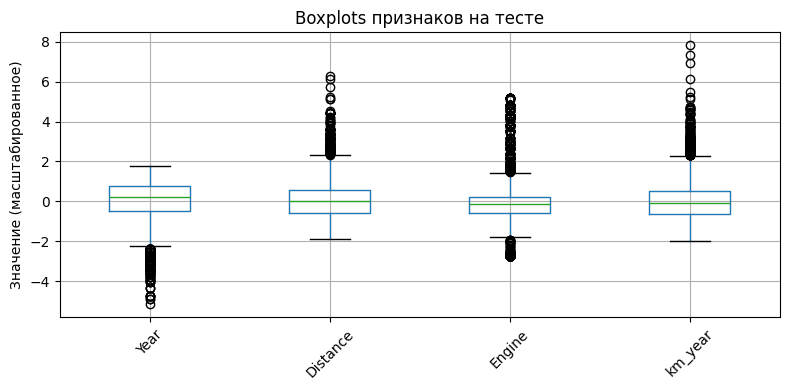

In [187]:
df_ = pd.DataFrame(X_test, columns  = X.columns)

plt.figure(figsize=(8, 4))
df_.boxplot(column=['Year', 'Distance', 'Engine', 'km_year'])
plt.title('Boxplots признаков на тесте')
plt.ylabel('Значение (масштабированное)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Исследование методов оценки цены

Опробуем алгоритм линейной регрессии на данных признаках. 

Самая простая модель регрессии. Предполагает, что зависимость между признаками и целевой переменной — линейная:

$$ \hat y = w_1\cdot Year + w_2 \cdot Distance + w_3 \cdot Engine + w_4 \cdot km_year$$

Такая модель предполагает линейную зависимость целевой переменной $\hat y$ (Price) от входных параметров. 

Цель обучения модели - найти оптимальные значения коэффицентов $ \{w_1, w_2, w_3, w_4\}$. Оптимальные значения - это такие значения, при которых средняя ошибка оценки цены $\hat y$ будет минимальна относительно ее реальных значений $y$. Другими словами мы хотим минимизировать риск дать неправильную оценку цены. Риск (среднюю ошибку / потери) мы будем называть `Loss`. 

Если предположить, что каждая наша запись в данных случайна и независима, то такой риск разумно оценить как
$$ L = {\frac{\sum{y - \hat y}^2}{N}}$$

Такая ошибка ($L$ - loss) назвывается [`Root Mean Square Error`](https://en.wikipedia.org/wiki/Mean_squared_error).  Средне-квадратическая ошибка рассчитывается для выборки длиной $N$. Фактически данная ошибка говорит следующее: чем дальше значения от реальных, тем больше в  квадрат раз штрафуется модель. Интерпретация аналогична геметрической.

Для того, чтобы обучить нашу модель - `LinearRegression` вызовим ее из библиотеки `linear_model`. Результат модели будем смотреть как значение `mean_absolute_error` (__MAE__)  и корня из `mean_squared_error` (__RMSE__).

Значения на которых мы проверяем точность будем называть словом [__метрика__](https://education.yandex.ru/handbook/ml/article/metriki-klassifikacii-i-regressii). 
<blockqute>
    
Отметим, что мы использовали обучение методом наименьших квадратов (`MSE`) - как наиболее точное аналитическое решение проблемы линейной регрессии. Ошибка __RMSE__ максимально характеризует результат нашего обучения. Сравнивая значения __RMSE__ для разных версий нашего алгоритма, обученных на одной и той же выборки мы можем сказать какая из версий лучше подходит для соотношения входных и выходных данных. То есть какая из версий моделей лучше объясняет это соотношение.

Однако,  для неискушенного в машинном обучении заказчика более интуитивно понятной  и ожидаемой величиной ошибки будет как раз среднее абсолютное отклонение __MAE__. 

$$ MAE = {\frac{\sum{|y - \hat y|}}{N}}$$

Можно сказать, что __RMSE__ характеризует случайный разброс значений, тогда как  __MAE__ характеризует смещение среднего значения.  Также отметим, что __MAE__ менее чувствтиельна к выбросам.

Плюсы __MAE__:
* Лего интерпретировать (и ML и в домене)
* Менее чувствителен к выбросам
* Значение в единицах измерения
* Оценка смещения предсказания
Минусы __MAE__:
* Одинаковый вес любым ошибкам, крупные ошибки, выбросы иногда дороже мелких
* Не дифференцируема в 0
* Применение: Задачи, где все ошибки одинаково важны 


Плюсы __RMSE__:
* За большие ошибки больший штраф
* Оценка дисперсии предсказаний
Минусы __RMSE__:
* Сложнее интерпретировать в предметной области
* Чувствительность к выбросам
* Применение: Задачи, где разброс ошибок критически важен
 

In [188]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error

clf = LinearRegression()
clf.fit(X_train, y_train)

y_hat_train = clf.predict(X_train)
y_hat_test = clf.predict(X_test)

train_mae = mean_absolute_error(y_hat_train, y_train)
train_rmse = np.sqrt(mean_squared_error(y_hat_train, y_train))

test_mae = mean_absolute_error(y_hat_test, y_test)
test_rmse = np.sqrt(mean_squared_error(y_hat_test, y_test))

print(f"Линейная регрессия:\nTest:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}\nTrain:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}")

Линейная регрессия:
Test:	MAE: 4120.1, 	RMSE: 6880.0
Train:	MAE: 4115.1, 	RMSE: 6798.5


Среди данных метрики не хватает только одного - как понять хорошо ли значение 4000 или 7000 или плохо. Эксперт в предметной области наверняка скажет вам об этом точно, но мы хотим ввести независимую оценку точности в относительных единицах. Например абсолюная процентная ошибка __MAPE__

$$ MAPE = 100\%\frac{реальность - прогноз}{реальность}$$

In [189]:
from sklearn.metrics import  mean_absolute_percentage_error
train_mape = mean_absolute_percentage_error(y_train, y_hat_train) * 100  # в процентах
test_mape = mean_absolute_percentage_error(y_test, y_hat_test) * 100  # в процентах
print(f"Линейная регрессия:")
print(f"Test:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}, \tMAPE: {test_mape:.1f}%")
print(f"Train:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}, \tMAPE: {train_mape:.1f}%")

Линейная регрессия:
Test:	MAE: 4120.1, 	RMSE: 6880.0, 	MAPE: 91.8%
Train:	MAE: 4115.1, 	RMSE: 6798.5, 	MAPE: 89.5%


Такой результат нам ни о чем не говорит, кроме того, что модель не подходит. Вероятно в модели слишьком мало признаков, или остались выбросы. Попробуем визуализировать результаты предсказаний чтобы понять точнее что не так.

Визуализация будет при помощи scatterplot истинных и предсказанных тестовых значений.

Красная пунктирная линия y = x — показывает, где должны лежать точки при идеальном предсказании.

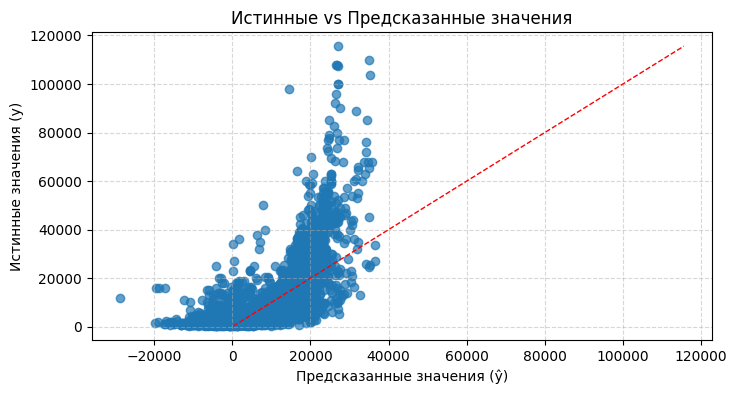

In [190]:
plt.figure(figsize=(8, 4))
plt.scatter(y_hat_test, y_test, alpha=0.7)
plt.xlabel('Предсказанные значения (ŷ)')
plt.ylabel('Истинные значения (y)')
plt.title('Истинные vs Предсказанные значения')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=1)  # линия идеального предсказания
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

Видим, что модель имеет очевидно не линейное поведение. Ширина разброса говорит о том, что результаты вообще не достаточно сильно связаны с реальными данными. 

__Вывод__: Нужна более сложная модель

Для начала давайте сделаем общую функцию для исследования моделей

Функция `evaluate_regressor`:
* производит fit заданного алгоритма
* делает предсказание на тренировочных и тестовых данных
* Считает MAE, RMSE и MAPE,
* Выводит их в удобном виде (если `verbose`),
* Строит график Истинные vs Предсказанные (если `plot_`).

In [191]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error

def evaluate_regressor(model, X_train, X_test, y_train, y_test, model_name="Модель", verbose = True, plot_ = True):
    """
    Обучает регрессионную модель, оценивает её по MAE, RMSE, MAPE и строит график.
    
    Параметры:
    - model: объект модели (например, LinearRegression())
    - X_train, X_test, y_train, y_test: данные
    - model_name: название модели для вывода
    
    Возвращает:
    - словарь с метриками
    """
    #------------------------------------------------
    # Обучение
    model.fit(X_train, y_train)
    
    # Предсказания
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    #---------------------------------------------------------
    # MAE и RMSE
    train_mae = mean_absolute_error(y_train, y_train_pred)
    train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
    test_mae = mean_absolute_error(y_test, y_test_pred)
    test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))
    
    # MAPE (с проверкой на нули)
    if np.any(y_train == 0) or np.any(y_test == 0):
        print("⚠️ Внимание: в y_train или y_test есть нули — MAPE не определён. Используется замена на np.inf.")
        train_mape = np.inf
        test_mape = np.inf
    else:
        train_mape = mean_absolute_percentage_error(y_train, y_train_pred) * 100
        test_mape = mean_absolute_percentage_error(y_test, y_test_pred) * 100
    #-------------------------------------------------------------
    if verbose:
        # Вывод метрик
        print(f"{model_name}:")
        print(f"Test:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}, \tMAPE: {test_mape:.1f}%")
        print(f"Train:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}, \tMAPE: {train_mape:.1f}%")
        print("-" * 60)

        if plot_:
            # График
            plt.figure(figsize=(8, 4))
            plt.scatter(y_test_pred, y_test, alpha=0.7, edgecolors='w', linewidth=0.5)
            plt.xlabel('Предсказанные значения (ŷ)')
            plt.ylabel('Истинные значения (y)')
            plt.title(f'{model_name}: Истинные vs Предсказанные')
            
            # Линия идеального предсказания (ограничена по предсказанным значениям)
            min_pred = min(y_test_pred.min(), y_test.min())
            max_pred = max(y_test_pred.max(), y_test.max())
            plt.plot([min_pred, max_pred], [min_pred, max_pred], 'r--', lw=1.5, label='Идеальное предсказание')
            
            plt.grid(True, linestyle='--', alpha=0.5)
            plt.legend()
            plt.tight_layout()
            plt.show()
    
    return { 'Name': model_name,
        'Train MAE': train_mae,
        'Train RMSE': train_rmse,
        'Train MAPE(%)': train_mape,
        'Test MAE': test_mae,
        'Test RMSE': test_rmse,
        'Test MAPE(%)': test_mape
    }

Исследуем несколько популярных методов регрессии на нашей задаче

1. __Линейная регрессия__ (LinearRegression)
* Как работает: проводит прямую линию через данные.
* Плюсы: очень простая, быстрая, понятная.
* Минусы: не может уловить кривые зависимости (например, «чем старше машина — тем быстрее падает цена»).
* Что посмотреть: Если график не похож на прямую — линейная регрессия недообучена.
  
2. __k-ближайших соседей__ (KNeighborsRegressor)
* Как работает: чтобы предсказать цену новой машины, находит 5 самых похожих из обучающей выборки и берёт среднее.
* Плюсы: может уловить любую форму зависимости (даже очень сложную!).
* Минусы:
    * Очень чувствителен к масштабу признаков (нужно масштабировать!),
    * Может переобучиться, если k слишком маленькое.
*  Что посмотреть:
    * На графике точки могут слипаться в группы.
    * Train MAE ≈ 0, а Test MAE — большой → переобучение!

3. __Дерево решений__ (DecisionTreeRegressor)
*  Как работает: задаёт вопросы вроде «Цена > 500 000?», «Год выпуска < 2015?» и т.д.
*  Плюсы: очень интерпретируемо — можно нарисовать дерево!
*  Минусы: сильно переобучается, если не ограничить глубину.

4. __Случайный лес__ (RandomForestRegressor)
*  Как работает: строит много деревьев решений, каждое смотрит на разные признаки, и усредняет их ответы.
*  Плюсы:
    *  Работает почти всегда хорошо «из коробки»,
    *  Не боится выбросов и нелинейностей,
    *  Не требует масштабирования.
*  Минусы: «чёрный ящик» — сложно понять, почему она так предсказала.
*  Что посмотреть:
    *  Часто лучшее качество из всех простых моделей.
    *  Но если Train RMSE ≈ 0, а Test — заметно хуже → тоже переобучение!

In [192]:
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

k-ближайших соседей (k=5):
Test:	MAE: 2659.9, 	RMSE: 4708.0, 	MAPE: 45.0%
Train:	MAE: 2164.3, 	RMSE: 3812.5, 	MAPE: 35.6%
------------------------------------------------------------


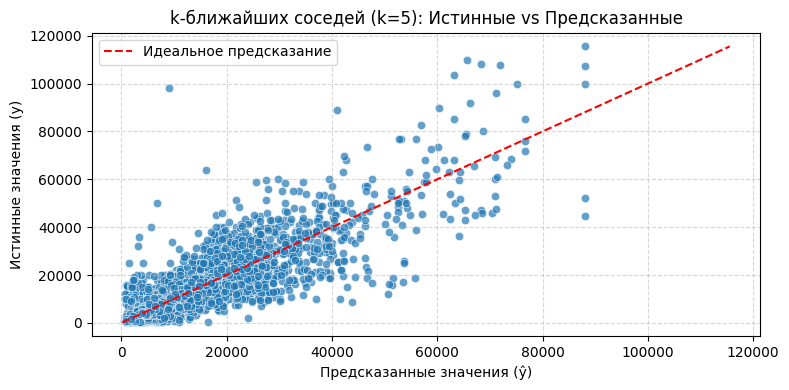

In [193]:
n_neighbors=5
knn = KNeighborsRegressor(n_neighbors=n_neighbors)
results_knn = evaluate_regressor(knn, X_train, X_test, y_train, y_test, f"k-ближайших соседей (k={n_neighbors})")

Для нелинйных алгоритмов данные куда-лучше ложаться.

Дерево решений (глубина=3):
Test:	MAE: 3380.9, 	RMSE: 5313.4, 	MAPE: 65.8%
Train:	MAE: 3415.6, 	RMSE: 5429.2, 	MAPE: 64.9%
------------------------------------------------------------


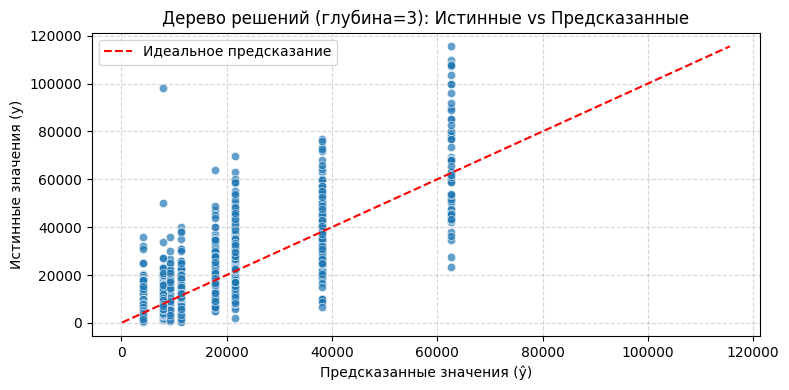

In [194]:
max_depth=3
tree = DecisionTreeRegressor(max_depth=max_depth, random_state=42)  # ограничим глубину
results_tree = evaluate_regressor(tree, X_train, X_test, y_train, y_test, f"Дерево решений (глубина={max_depth})")

Дерево решений по своей природе имеет дискретный характер результатов. Чем глубже дерево - тем меньше дискрет, но выше переобучение

Случайный лес 20:
Test:	MAE: 2691.1, 	RMSE: 4727.5, 	MAPE: 46.2%
Train:	MAE: 1171.0, 	RMSE: 2121.0, 	MAPE: 19.4%
------------------------------------------------------------


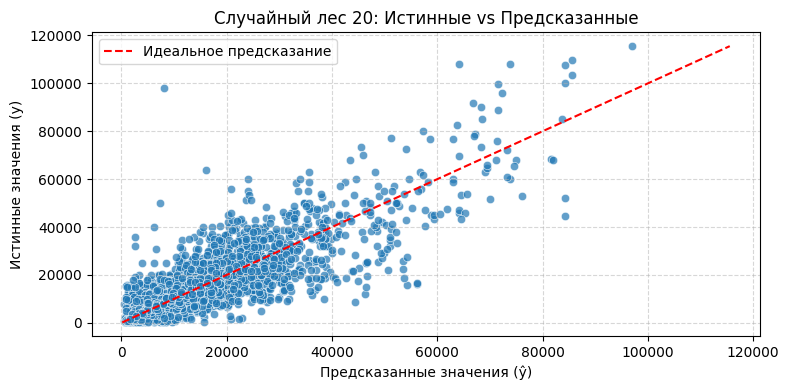

In [195]:
n_estimators=20
rf = RandomForestRegressor(n_estimators=n_estimators, random_state=42)
results_rf = evaluate_regressor(rf, X_train, X_test, y_train, y_test, f"Случайный лес {n_estimators}")

Набор деревьев с разными подвыборками дает неприрывный результат 

In [196]:
# Список моделей для сравнения
models = [
    (LinearRegression(), "Линейная регрессия"),
    (KNeighborsRegressor(n_neighbors=10), "10-ближайших соседей"),
    (DecisionTreeRegressor(max_depth=6, random_state=42), "Дерево решений"),
    (RandomForestRegressor(n_estimators=10, random_state=42), "Случайный лес (10 деревьев)")
]

# Список для хранения результатов
results = []

# Цикл по моделям
for model, name in models:
    result = evaluate_regressor(
            model, X_train, X_test, y_train, y_test,
            model_name=name, verbose=False, plot_=False
        )
    results.append(result)
    

In [197]:
# Преобразуем список словарей в DataFrame
df_results = pd.DataFrame(results)
df_results

,Name,Train MAE,Train RMSE,Train MAPE(%),Test MAE,Test RMSE,Test MAPE(%)
0,Линейная регрессия,4115.103229,6798.546680,89.531527,4120.125329,6880.009837,91.789759
1,10-ближайших соседей,2346.755496,4107.273166,38.878932,2580.297350,4514.773543,44.632208
2,Дерево решений,2605.577420,4387.971353,45.253117,2657.370074,4540.164747,46.166626
3,Случайный лес (10 деревьев),1204.310853,2209.216278,19.952136,2719.981432,4769.783913,46.989489


### Упражнения
1. Провести анализ зависимости полученных результатов от поведения отдельных признаков.
2. Провести анализ точности предсказания цены для набора данных с очищенными признаками
3. Популярными моделями для регресии в не рамко scikit-learn, но на основе интерфейса scikit-learn являются модели бустинга, например:

* `from xgboost import XGBRegressor`
* `from lightgbm import LGBMRegressor`
* `from catboost import CatBoostRegressor`

предлагается проверить точность для этих моделей
   

4. В данной практике мы не рассматривали категориальные признаки. Их кодирование - это отдельная процедура и не всегда однозначная. Однако в рамках упражнения предлагается проверить возможность кодирования категориальных признаков как среднего значения цены для их некоторой комбинации. Например
* введем столбец средняя цена по марке и году;
* для трансмиссии введем значения 1 - автомат, 0 - ручная коробка.
В упражнении предлагается проверить как этот фактор скажется на результатах предсказания.

5. Мы выбрали тест каким-то случайным образом как 30% от выборки. Действительно ли точность на таком тесте - это верное ее значение?
   * Проверьте точность при увеличении тестовой выборки до 50%
   * Используйте процедуру k-folds  для получения менее смещенной оценке точности:
  
     

In [198]:
from sklearn.model_selection import KFold, cross_validate

In [199]:
# 2. Создадим модель
rf = RandomForestRegressor(
    n_estimators=100,
    random_state=42,
    n_jobs=-1
)

# 3. Настроим KFold
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# 4. Определим метрики (можно добавить любые)
scoring = {
    'mae': 'neg_mean_absolute_error',
    'rmse': 'neg_root_mean_squared_error',  # доступно в sklearn >= 1.4
    'r2': 'r2'
}

# 5. Запустим кросс-валидацию
cv_results = cross_validate(
    rf, X, y,
    cv=kf,
    scoring=scoring,
    return_train_score=True,  # чтобы видеть переобучение
    n_jobs=-1
)

# 6. Выведем результаты
print("Результаты KFold кросс-валидации (5 фолдов):")
print("-" * 50)

# Test scores
test_mae = -cv_results['test_mae']
test_rmse = -cv_results['test_rmse']
test_r2 = cv_results['test_r2']

print(f"Test MAE:  {test_mae.mean():.3f} ± {test_mae.std():.3f}")
print(f"Test RMSE: {test_rmse.mean():.3f} ± {test_rmse.std():.3f}")
print(f"Test R²:   {test_r2.mean():.3f} ± {test_r2.std():.3f}")

# Train scores (для анализа переобучения)
train_mae = -cv_results['train_mae']
train_rmse = -cv_results['train_rmse']
train_r2 = cv_results['train_r2']

print(f"\nTrain MAE:  {train_mae.mean():.3f} ± {train_mae.std():.3f}")
print(f"Train RMSE: {train_rmse.mean():.3f} ± {train_rmse.std():.3f}")
print(f"Train R²:   {train_r2.mean():.3f} ± {train_r2.std():.3f}")

# Анализ переобучения
print("\nАнализ переобучения:")
if train_r2.mean() - test_r2.mean() > 0.05:
    print("⚠️  Возможное переобучение (разрыв R² > 0.05)")
else:
    print("✅ Модель обобщается хорошо")

Результаты KFold кросс-валидации (5 фолдов):
--------------------------------------------------
Test MAE:  2628.485 ± 16.358
Test RMSE: 4656.234 ± 49.910
Test R²:   0.765 ± 0.009

Train MAE:  1166.129 ± 4.298
Train RMSE: 2117.046 ± 21.695
Train R²:   0.951 ± 0.001

Анализ переобучения:
⚠️  Возможное переобучение (разрыв R² > 0.05)


Предлагается провести процедуру k-folds и для остальных алгоритмов

# В качестве бонуса (_не обязательно_)

Проведем анализ выбросов исследуемого алгоритма

In [84]:
n_neighbors=5
clf = KNeighborsRegressor(n_neighbors=n_neighbors)


In [85]:
clf.fit(X_train, y_train)

y_hat_train = clf.predict(X_train)
y_hat_test = clf.predict(X_test)

train_mae = mean_absolute_error(y_hat_train, y_train)
train_rmse = np.sqrt(mean_squared_error(y_hat_train, y_train))

test_mae = mean_absolute_error(y_hat_test, y_test)
test_rmse = np.sqrt(mean_squared_error(y_hat_test, y_test))

train_mape = mean_absolute_percentage_error(y_train, y_hat_train) * 100  # в процентах
test_mape = mean_absolute_percentage_error(y_test, y_hat_test) * 100  # в процентах
print(f"Линейная регрессия:")
print(f"Test:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}, \tMAPE: {test_mape:.1f}%")
print(f"Train:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}, \tMAPE: {train_mape:.1f}%")

Линейная регрессия:
Test:	MAE: 2659.9, 	RMSE: 4708.0, 	MAPE: 45.0%
Train:	MAE: 2164.3, 	RMSE: 3812.5, 	MAPE: 35.6%


In [108]:
import plotly.express as px
import pandas as pd
import numpy as np

# Создаём DataFrame для графика
df_errors = pd.DataFrame(X, columns = X.columns)  # копируем признаки
df_errors['y_true'] = y
df_errors['y_pred'] = clf.predict(scaler.transform(X))
df_errors['index'] = plot_df.index  # сохраняем исходный индекс

# Формируем текст для всплывающей подсказки (tooltip)
def make_hover_text(row):
    text = f"<b>Индекс:</b> {row['index']}<br>"
    text += f"<b>Истинное (y):</b> {row['y_true']:.3f}<br>"
    text += f"<b>Предсказанное (ŷ):</b> {row['y_pred']:.3f}<br>"
    text += f"<b>MAE (ŷ-y):</b> {row['y_pred']-row['y_true']:.3f}<br>"   
    text += "<br><b>Признаки:</b><br>"
    for col in ['Year', 'Distance', 'Engine', 'km_year']:
        text += f"• {col}: {row[col]:.3f}<br>"
    return text

df_errors['hover_text'] = df_errors.apply(make_hover_text, axis=1)

# Строим интерактивный scatter plot
fig = px.scatter(
    df_errors,
    x='y_pred',
    y='y_true',
    hover_name='index',
    hover_data={'y_pred': False, 'y_true': False, 'hover_text': True},
    labels={
        'y_pred': 'Предсказанные значения (ŷ)',
        'y_true': 'Истинные значения (y)'
    },
    title=f'Истинные vs Предсказанные значения (MAE { (df_errors['y_true']  - df_errors['y_pred']).abs().mean():.1f})',
    width=800,
    height=500
)

# Добавляем линию идеального предсказания
min_val = min(df_errors['y_true'].min(), df_errors['y_pred'].min())
max_val = max(df_errors['y_true'].max(), df_errors['y_pred'].max())

fig.add_shape(
    type="line",
    x0=min_val, y0=min_val,
    x1=max_val, y1=max_val,
    line=dict(color="red", dash="dash", width=2),
    name="Идеальное предсказание"
)

# Настраиваем hover
fig.update_traces(
    hovertemplate='%{customdata}<extra></extra>',
    customdata=plot_df['hover_text']
)

# Показываем график
fig.show()

Выберем теперь индексы с явно завышенной ошибкой (боле чем 2 MAE)

In [109]:
# Условие: y_true > y_pred + 20000
condition = plot_df['y_true'] > plot_df['y_pred'] + 40000

# Получаем индексы таких строк
indices_above = plot_df[condition].index.tolist()
indices_above

[5787,
 6338,
 8052,
 12378,
 15920,
 20743,
 21611,
 21997,
 23334,
 23373,
 23375,
 24172]

Выводы относительно явных аномалий позволяют более детально скорректировать результаты прогноза

Другим вариантом исправлений будет поиск, например средней ошибки по году

In [127]:
df_errors = X.copy()   
df_errors['y_true'] = y
df_errors['y_pred'] = clf.predict(scaler.transform(X))
df_errors['abs_error'] = df_errors['y_true']-df_errors['y_pred']

In [128]:
# Группировка по признаку (например, по году)
error_by_year = df_errors.groupby('Year')['abs_error'].agg(['mean', 'count'])
print(error_by_year.sort_values('mean', ascending=False).head(10))

             mean  count
Year                    
1975  5690.000000      2
1977  2698.433333      6
1979  2476.040000      5
1974  1672.400000     10
1981   735.962500     16
1984   715.466667     33
2019   499.334140    413
1986   308.162264     53
1985   235.660870     46
1980   208.585714     14


Выборка 1975 - 1979 дала наибольший вклда в ошибку

Дополнительно покажем, что в ряде случаев возмжно получение результатов при помощи линейных алгоритмов + простых преорабзований не хуже, чем при использовании продвинутых алгоритмов машинного обучения. В примере ниже использована линейная регрессия, но для логорифма от цены.

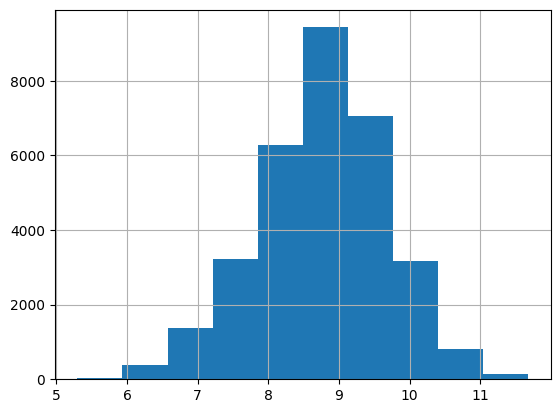

In [160]:
y = df["Price"].copy().apply(lambda x:np.log(x))
X = df.drop(["Price"], axis = 1)
y.hist();

Распределение логорифма цен куда нагляднее. Узнаем как это скажется на результатх предсказаний

In [161]:
X_train_, X_test_, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train_)
X_test = scaler.transform(X_test_)

clf = LinearRegression()
clf.fit(X_train, y_train)

y_hat_train = np.exp(clf.predict(X_train))
y_hat_test  = np.exp(clf.predict(X_test))
y_train = np.exp(y_train)
y_test  = np.exp(y_test)

train_mae = mean_absolute_error(y_hat_train, y_train)
train_rmse = np.sqrt(mean_squared_error(y_hat_train, y_train))

test_mae = mean_absolute_error(y_hat_test, y_test)
test_rmse = np.sqrt(mean_squared_error(y_hat_test, y_test))

train_mape = mean_absolute_percentage_error(y_train, y_hat_train) * 100  # в процентах
test_mape = mean_absolute_percentage_error(y_test, y_hat_test) * 100  # в процентах
print(f"Линейная регрессия:")
print(f"Test:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}, \tMAPE: {test_mape:.1f}%")
print(f"Train:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}, \tMAPE: {train_mape:.1f}%")

Линейная регрессия:
Test:	MAE: 3022.1, 	RMSE: 5914.2, 	MAPE: 40.2%
Train:	MAE: 3037.8, 	RMSE: 5944.5, 	MAPE: 40.4%


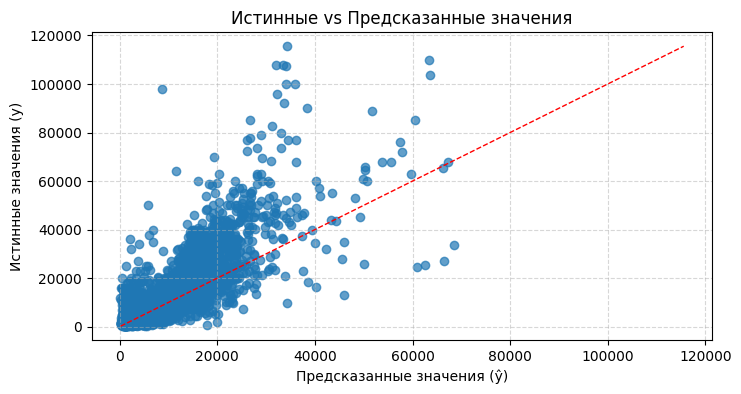

In [162]:
plt.figure(figsize=(8, 4))
plt.scatter(y_hat_test, y_test, alpha=0.7)
plt.xlabel('Предсказанные значения (ŷ)')
plt.ylabel('Истинные значения (y)')
plt.title('Истинные vs Предсказанные значения')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=1)  # линия идеального предсказания
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

А теперь попробуем поправить линейную регрессию - сделаем из нее полиномиальную регрессию

In [164]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
import numpy as np

# Предполагается, что y уже в логарифмированном виде (например, y = np.log(original_y))
X_train_, X_test_, y_train_log, y_test_log = train_test_split(X, y, test_size=0.3, random_state=42)

# === Линейная регрессия (для сравнения) ===
scaler_lin = StandardScaler()
X_train_lin = scaler_lin.fit_transform(X_train_)
X_test_lin = scaler_lin.transform(X_test_)

clf_lin = LinearRegression()
clf_lin.fit(X_train_lin, y_train_log)

# === Полиномиальная регрессия ===
degree = 3  # можно попробовать 2, 3 — но осторожно с переобучением!

poly = PolynomialFeatures(degree=degree, include_bias=False)
X_train_poly = poly.fit_transform(X_train_)
X_test_poly = poly.transform(X_test_)

# Масштабирование полиномиальных признаков (очень важно!)
scaler_poly = StandardScaler()
X_train_poly_scaled = scaler_poly.fit_transform(X_train_poly)
X_test_poly_scaled = scaler_poly.transform(X_test_poly)

clf_poly = LinearRegression()
clf_poly.fit(X_train_poly_scaled, y_train_log)

# === Предсказания и оценка (в исходной шкале) ===
def evaluate_model(clf, X_train, X_test, y_train_log, y_test_log, model_name):
    y_pred_train_log = clf.predict(X_train)
    y_pred_test_log = clf.predict(X_test)
    
    # Возврат в исходную шкалу
    y_train_orig = np.exp(y_train_log)
    y_test_orig = np.exp(y_test_log)
    y_pred_train_orig = np.exp(y_pred_train_log)
    y_pred_test_orig = np.exp(y_pred_test_log)
    
    train_mae = mean_absolute_error(y_pred_train_orig, y_train_orig)
    train_rmse = np.sqrt(mean_squared_error(y_pred_train_orig, y_train_orig))
    test_mae = mean_absolute_error(y_pred_test_orig, y_test_orig)
    test_rmse = np.sqrt(mean_squared_error(y_pred_test_orig, y_test_orig))
    
    # MAPE: будьте осторожны — может быть нестабильным при малых y
    train_mape = mean_absolute_percentage_error(y_train_orig, y_pred_train_orig) * 100
    test_mape = mean_absolute_percentage_error(y_test_orig, y_pred_test_orig) * 100
    
    print(f"\n{model_name}:")
    print(f"Test:\tMAE: {test_mae:.1f}, \tRMSE: {test_rmse:.1f}, \tMAPE: {test_mape:.1f}%")
    print(f"Train:\tMAE: {train_mae:.1f}, \tRMSE: {train_rmse:.1f}, \tMAPE: {train_mape:.1f}%")

# Оценка моделей
evaluate_model(clf_lin, X_train_lin, X_test_lin, y_train_log, y_test_log, "Линейная регрессия")
evaluate_model(clf_poly, X_train_poly_scaled, X_test_poly_scaled, y_train_log, y_test_log, f"Полиномиальная регрессия (степень {degree})")


Линейная регрессия:
Test:	MAE: 3022.1, 	RMSE: 5914.2, 	MAPE: 40.2%
Train:	MAE: 3037.8, 	RMSE: 5944.5, 	MAPE: 40.4%

Полиномиальная регрессия (степень 3):
Test:	MAE: 2696.8, 	RMSE: 4859.3, 	MAPE: 36.6%
Train:	MAE: 2683.8, 	RMSE: 4878.1, 	MAPE: 35.9%


Попробуем получить некоторую интерпретацию признаков

In [168]:
 # Получаем коэффициенты и восстанавливаем их в исходной шкале
feature_names = X.columns  # предполагается, что X — DataFrame
scaled_coefs = clf.coef_
scaler_mean = scaler.mean_
scaler_scale = scaler.scale_

# Восстанавливаем коэффициенты в исходной шкале признаков
original_coefs = scaled_coefs / scaler_scale

# Создаём DataFrame для удобства
coef_df = pd.DataFrame({
    'feature': feature_names,
    'coef_scaled': scaled_coefs,
    'coef_original_scale': original_coefs,
    'effect_on_y (%)': (np.exp(original_coefs) - 1) * 100  # прирост y в %
}).sort_values('effect_on_y (%)', key=abs, ascending=False)

print("\n=== Интерпретация коэффициентов (линейная регрессия) ===")
print("Модель предсказывает log(y). Коэффициенты показывают, как изменится y (в %),")
print("если признак увеличить на 1 единицу (в его исходных единицах измерения):\n")

print(coef_df[['feature', 'effect_on_y (%)']].to_string(index=False, float_format="{:.2f}%".format))


=== Интерпретация коэффициентов (линейная регрессия) ===
Модель предсказывает log(y). Коэффициенты показывают, как изменится y (в %),
если признак увеличить на 1 единицу (в его исходных единицах измерения):

 feature  effect_on_y (%)
    Year            8.92%
  Engine            0.05%
 km_year            0.00%
Distance           -0.00%


Увеличение года выпуска на 1 год → снижение цены на ~9%

### Упражнение
1. Провести анализ возможности преобразования входных признаков в рамках линейной модели